# Домашнее задание

В этом задании мы попрактикуемся в методах снижения размерности и кластеризации данных.

## Задание 1. Кластеризация типов движений (5 баллов)

В этой части задания мы будем работать с набором данных Samsung Human Activity Recognition. Набор данных заранее предобработан, если есть желание покопаться в исходнике, его легко нагуглить. Скачайте данные по ссылке ниже

https://drive.google.com/file/d/16ISu7lMumt5rbticbOggHMRjwTGBETtO/view?usp=sharing

Данные поступают с акселерометров и гироскопов мобильных телефонов Samsung Galaxy S2, также известен вид активности человека с телефоном в кармане – ходил ли он, стоял, лежал, сидел или шел вверх/вниз по лестнице.

Представим, что вид активности нам неизвестнен, и попробуем кластеризовать людей чисто на основе имеющихся признаков.

Также есть методичка/овервью от sklearn:
[Методичка](https://scikit-learn.org/stable/modules/clustering.html#clustering-performance-evaluation)

In [81]:
import time

import pandas as pd
import pyamg

from skimage.color import rgb2gray 

from sklearn.feature_extraction import image
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import (
    KMeans,
    AgglomerativeClustering,
    SpectralClustering,
    spectral_clustering,
    DBSCAN,
    BisectingKMeans
)

from sklearn.metrics import (
    rand_score,
    adjusted_rand_score,
    v_measure_score,
    silhouette_score,
    pair_confusion_matrix
)

In [2]:
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt


# plt.style.use(['seaborn-darkgrid'])
plt.rcParams['figure.figsize'] = (12, 9)
plt.rcParams['font.family'] = 'DejaVu Sans'

%matplotlib inline
%config InlineBackend.figure_format="retina"

RANDOM_STATE = 42

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

### Задание 1.0 (0.1 балл)
Прочитайте данные из файлов и объедните тестовую и обучающие выборки.

В файлах ```..._labels``` лежат настоящие классы. Их также объедините, но в отдельную переменную (например ```y```). Данный вектор для кластеризации нам не нужен, но мы будем смотреть по нему метрики.

In [3]:
# path = '/content/drive/MyDrive/ml_hw/'
path = 'data/'

In [233]:
#your code here
X = (
    pd.concat(
        [pd.read_csv(f'{path}samsung_train.txt', sep=',', header=None),
        pd.read_csv(f'{path}samsung_test.txt', sep=',', header=None)]
    )
    .reset_index(drop=True)
    [0].apply(lambda x: x.replace('  ', ' '))
    .str.split(' ',expand=True)
    .replace('', np.nan)
    .drop([0], axis=1)
    .astype(float)
)

y = (
    pd.concat(
        [pd.read_csv(f'{path}samsung_train_labels.txt', sep=',', header=None),
        pd.read_csv(f'{path}samsung_test_labels.txt', sep=',', header=None)]
    )
    .reset_index(drop=True)
)

/var/folders/m7/0t6_qp9s4qd1b4ttggc9q6brhw38s_/T/ipykernel_25583/4256372513.py:3: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  pd.concat(


In [9]:
X.head(5)

,1,2,3,4,5,6,7,8,9,10,...,552,553,554,555,556,557,558,559,560,561
0,0.288585,-0.020294,-0.132905,-0.995279,-0.983111,-0.913526,-0.995112,-0.983185,-0.923527,-0.934724,...,-0.074323,-0.298676,-0.710304,-0.112754,0.030400,-0.464761,-0.018446,-0.841247,0.179941,-0.058627
1,0.278419,-0.016411,-0.123520,-0.998245,-0.975300,-0.960322,-0.998807,-0.974914,-0.957686,-0.943068,...,0.158075,-0.595051,-0.861499,0.053477,-0.007435,-0.732626,0.703511,-0.844788,0.180289,-0.054317
2,0.279653,-0.019467,-0.113462,-0.995380,-0.967187,-0.978944,-0.996520,-0.963668,-0.977469,-0.938692,...,0.414503,-0.390748,-0.760104,-0.118559,0.177899,0.100699,0.808529,-0.848933,0.180637,-0.049118
3,0.279174,-0.026201,-0.123283,-0.996091,-0.983403,-0.990675,-0.997099,-0.982750,-0.989302,-0.938692,...,0.404573,-0.117290,-0.482845,-0.036788,-0.012892,0.640011,-0.485366,-0.848649,0.181935,-0.047663
4,0.276629,-0.016570,-0.115362,-0.998139,-0.980817,-0.990482,-0.998321,-0.979672,-0.990441,-0.942469,...,0.087753,-0.351471,-0.699205,0.123320,0.122542,0.693578,-0.615971,-0.847865,0.185151,-0.043892


In [10]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10299 entries, 0 to 10298
Columns: 561 entries, 1 to 561
dtypes: float64(561)
memory usage: 44.1 MB


In [11]:
X.shape

(10299, 561)

In [12]:
y.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10299 entries, 0 to 10298
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   0       10299 non-null  int64
dtypes: int64(1)
memory usage: 80.6 KB


In [13]:
y.shape

(10299, 1)

In [14]:
np.unique(y)

array([1, 2, 3, 4, 5, 6])

Эти метки соответствуют:

1 - ходьбе,
2 - подъему вверх по лестнице,
3 - спуску по лестнице,
4 - сидению,
5 - стоянию,
6 - лежанию

### Задание 1.1 (0.5 баллов)

Отмасштабируйте выборку с помощью ```StandardScaler```.

[Документация](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html)

In [234]:
#your code here
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [16]:
X_scaled[:5, :]

array([[ 2.10533854e-01, -6.87026385e-02, -4.52194533e-01, ...,
        -6.74432366e-01,  3.82007658e-01, -1.61505480e-02],
       [ 6.02084832e-02,  3.59023537e-02, -2.75221885e-01, ...,
        -6.81359801e-01,  3.83147865e-01, -1.20627169e-04],
       [ 7.84597052e-02, -4.64269585e-02, -8.55480582e-02, ...,
        -6.89470939e-01,  3.84288531e-01,  1.92144041e-02],
       [ 7.13747004e-02, -2.27793764e-01, -2.70741068e-01, ...,
        -6.88915135e-01,  3.88536155e-01,  2.46242686e-02],
       [ 3.37379044e-02,  3.16173394e-02, -1.21379506e-01, ...,
        -6.87381033e-01,  3.99066085e-01,  3.86485818e-02]])

### Задание 1.2 (0.6 баллов)

Мы не обсуждали методы понижения размерности, поэтому можно воспользоваться ими в качестве чёрного ящика. Если есть желание, можно почитать про PCA в [Конспекте](https://github.com/esokolov/ml-course-hse/blob/master/2020-fall/lecture-notes/lecture12-factorizations.pdf). Понизьте размерность с помощью ```PCA```, оставляя столько компонент, сколько нужно для того, чтобы объяснить как минимум 90% дисперсии отмасштабированных данных. Для этого сумма массива pca.explained_variance_ratio_ должна быть больше 0.9.  ```random_state``` используйте из объявленной в самом начале переменной ```RANDOM_STATE``` (42).

[Документация](https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html)

In [235]:
#your code here
pca = PCA(n_components=67, random_state=RANDOM_STATE)
X_pca = pca.fit_transform(X_scaled)

In [18]:
sum(pca.explained_variance_ratio_)

0.9033193923833375

### Задание 1.3 (0.3 баллов)

Визуализируйте данные в проекции на первые две главные компоненты. Используйте ```cmap="virdis"``` или любой другой, с которым будет красиво :)

In [236]:
pca_plot = PCA(n_components=2, random_state=RANDOM_STATE)
X_pca_plot = pca_plot.fit_transform(X_scaled)

In [42]:
sum(pca_plot.explained_variance_ratio_)

0.5697740681020974

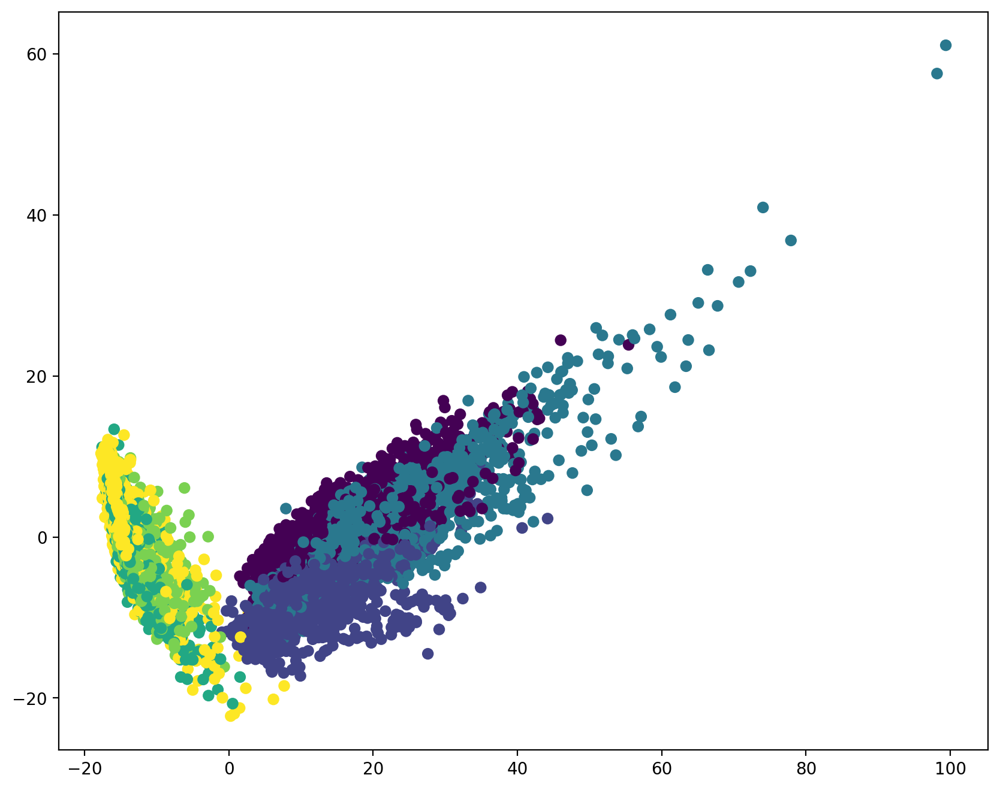

In [417]:
#your code here
plt.figure(figsize=(10, 8))
plt.scatter(x=X_pca_plot[:, 0], y=X_pca_plot[:, 1], c=y, cmap='viridis')

### Задание 1.4 (0.4 балла)

Сделайте кластеризацию данных методом ```KMeans```, обучив модель на данных со сниженной за счет ```PCA```
размерностью. В данном случае нужно искать 6 кластеров (изначально у нас 6 классов). Засеките время обучения и время инференса.

Параметры:

```n_clusters = 6``` (число уникальных меток целевого класса = 6)

```n_init = 100```

```random_state = RANDOM_STATE``` (для воспроизводимости результата, не забывайте указывать его и дальше!)

[Документация](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html)

In [91]:
#your code here
kmeans_1 = KMeans(n_clusters=6, random_state=RANDOM_STATE, n_init=100)

In [115]:
start_time = time.time()

kmeans_1.fit(X_pca)

end_time = time.time()
execution_time = end_time - start_time

print(f"Время выполнения программы: {execution_time} секунд")

Время выполнения программы: 2.018989086151123 секунд


In [93]:
kmeans_1.labels_

array([2, 2, 2, ..., 1, 1, 1], dtype=int32)

In [94]:
%time
kmeans_1.predict(X_pca[:10])

CPU times: user 3 µs, sys: 1 µs, total: 4 µs
Wall time: 6.91 µs


array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2], dtype=int32)

### Задание 1.5 (0.2 балла)

Визуализируйте данные в проекции на первые две главные компоненты. Раскрасьте точки в соответствии с полученными метками кластеров.

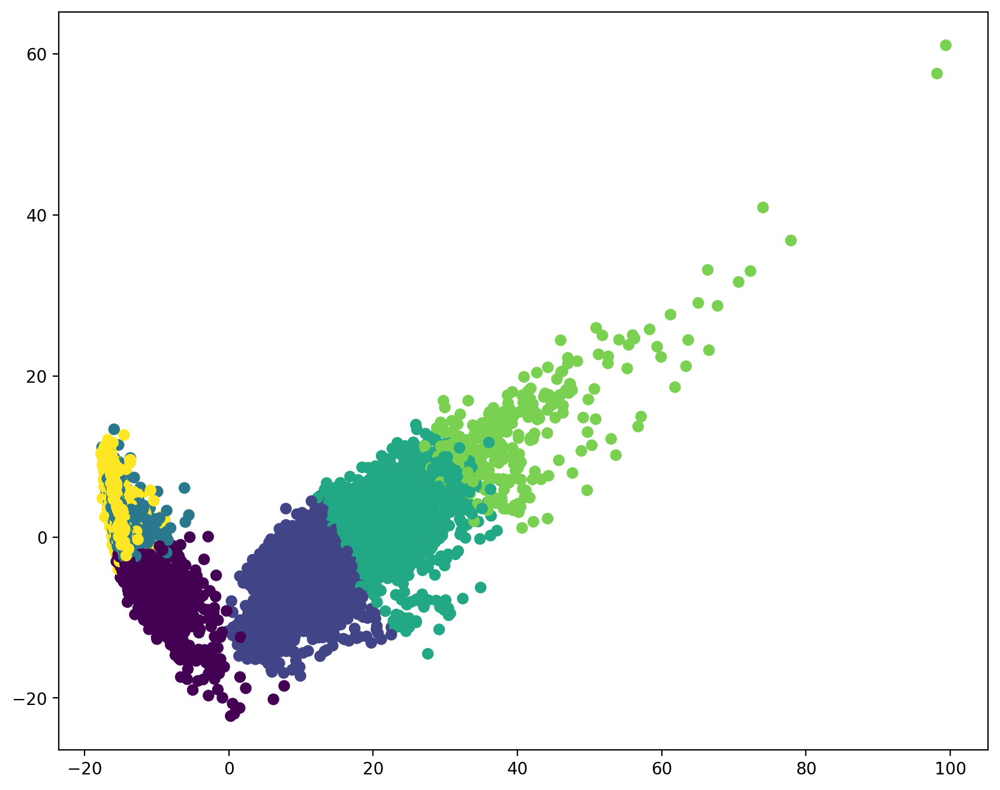

In [418]:
#your code here
plt.figure(figsize=(10, 8))
plt.scatter(x=X_pca_plot[:, 0], y=X_pca_plot[:, 1], c=kmeans_1.labels_, label=kmeans_1.labels_, cmap='viridis')

### Задание 1.6 (0.3 баллов)

Выберите какие-то метрики (минимум две) из известных вам или из методички (ссылка в начале дз, пункт 2.3.10), объясните ваш выбор.

Выведите на экран значения метрик качества кластеризации и используйте их далее.

In [96]:
y_true = y.to_numpy().reshape(1, -1)[0]

In [97]:
#your code here
rand_score(y_true, kmeans_1.labels_)

0.8247737945207192

If C is a ground truth class assignment and K the clustering, let us define ```a``` and ```b``` as:

- ```a```, the number of pairs of elements that are in the same set in C and in the same set in K  
- ```b```, the number of pairs of elements that are in different sets in C and in different sets in K
The unadjusted Rand index is then given by:
$$
\text{RI} = \frac{a + b}{C_2^{n_{samples}}}
$$

In [98]:
adjusted_rand_score(y_true, kmeans_1.labels_)

0.41963455806557315

In [99]:
v_measure_score(y_true, kmeans_1.labels_)

0.5600660985828636

$$
\text{FMI} = \frac{\text{TP}}{\sqrt{(\text{TP} + \text{FP}) (\text{TP} + \text{FN})}}
$$

In [100]:
pair_confusion_matrix(y_true, kmeans_1.labels_)

array([[77158932, 11014712],
       [ 7569622, 10315836]])

$$
\begin{eqnarray*}
 C_{00}: & & \textnormal{number of pairs with both clusterings having the samples not clustered together}\\
 C_{10}: & & \textnormal{number of pairs with the true label clustering having the samples clustered together
 but the other clustering not having the samples clustered together}\\
 C_{01}: & & \textnormal{number of pairs with the true label clustering not having the samples clustered
 together but the other clustering having the samples clustered together}\\
 C_{11}: & & \textnormal{number of pairs with both clusterings having the samples clustered together}\\
\end{eqnarray*}
$$

In [101]:
%time
silhouette_score(X_pca, kmeans_1.labels_, metric='euclidean')

CPU times: user 2 µs, sys: 2 µs, total: 4 µs
Wall time: 5.96 µs


0.14039943451228956

*Silhouette*  
Scores around zero indicate overlapping clusters.  
The score is higher when clusters are dense and well separated, which relates to a standard concept of a cluster.

In [128]:
def print_metrics(X=X_pca, y_true=y_true, labels=kmeans_1.labels_):
    print('Random Index:', rand_score(y_true, labels))
    print('V-measure:', v_measure_score(y_true, labels))
    print('Silhouette:', silhouette_score(X_pca, labels, metric='euclidean'))

__Ответ:__
Выбрал много метрик, чтобы их протестировать, лучше всего интерпретируются Random Index (так как правильные метки кластеров нам известны) и V-мера (от 0 до 1, можно быстро увидеть улучшение качества, при этом скор не будет звышенным с учетом и ложныъ предсказаний).

### Задание 1.7 (0.8 баллов)
Теперь попробуем сделать кластеризацию с помощью ```AgglomerativeClustering```.

Вновь визуализируйте данные с раскраской по полученным меткам и выведите метрики. Засеките время обучения и время инференса. Сравните с ```KMeans```.

Ответьте на следующие вопросы:
* Стало ли лучше?
* Почему?

[Документация](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.AgglomerativeClustering.html)

In [117]:
#your code here
ag_cluster = AgglomerativeClustering(n_clusters=6, metric='euclidean')

In [118]:
start_time = time.time()

ag_cluster.fit(X_pca)

end_time = time.time()
execution_time = end_time - start_time

print(f"Время выполнения программы: {execution_time} секунд")

Время выполнения программы: 5.231333017349243 секунд


In [119]:
ag_cluster.labels_

array([5, 5, 5, ..., 2, 2, 2])

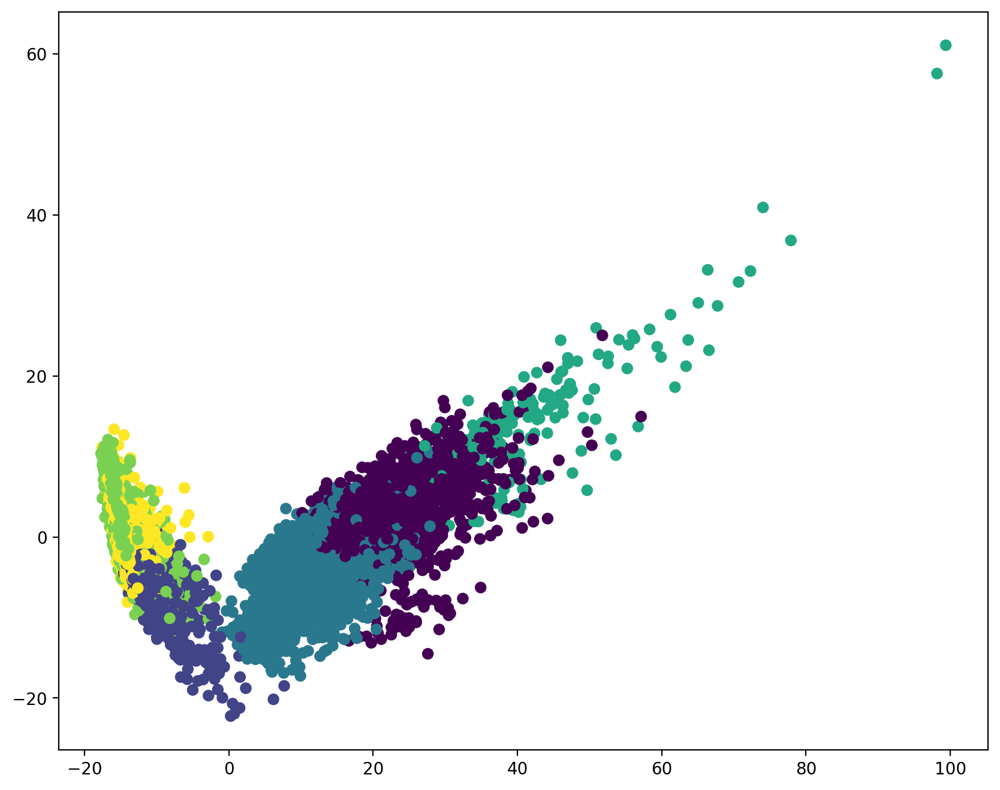

In [419]:
plt.figure(figsize=(10, 8))
plt.scatter(x=X_pca_plot[:, 0], y=X_pca_plot[:, 1], c=ag_cluster.labels_, label=ag_cluster.labels_, cmap='viridis')

In [129]:
print_metrics(X=X_pca, y_true=y_true, labels=ag_cluster.labels_)

Random Index: 0.8388131930440067
V-measure: 0.6134898023843361
Silhouette: 0.13921887014513545


__Ответ:__ Метрики стали показывать качество лучше, чем было в Kmeans. Причина этого может быть в расположении объектов таким образом, что они не образуют явно разделимые группы и Kmeans тяжело подобрать нужные центры масс, так как происходит сильное наслоение.

### Задание 1.8 (0.8 баллов)

Попробуйте применить другие методы кластеризации из sklearn.  Засеките время обучения и время инференса. Также вычислите метрики качества, визуализируйте результаты, после чего сделайте вывод о том, какой метод сработал лучше.

__Спектральная кластеризация__

In [239]:
X_pca.shape

(10299, 67)

In [240]:
spec_clust = SpectralClustering(
    n_clusters=6, eigen_solver=None,
    random_state=RANDOM_STATE, n_init=10, gamma=1.0
)

*Ждал около 2 часов, не посчиталась моделька* :(

In [242]:
start_time = time.time()

spec_clust.fit(X_pca)

end_time = time.time()
execution_time = end_time - start_time

print(f"Время выполнения программы: {execution_time} секунд")

/Users/dsbulg10/Desktop/study/repos/ml_study_hws/env/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:301: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


KeyboardInterrupt: 

In [ ]:
plt.figure(figsize=(10, 8))
plt.scatter(x=X_pca_plot[:, 0], y=X_pca_plot[:, 1], c=spec_clust.labels_, label=bis_means.labels_, cmap='viridis')

In [ ]:
print_metrics(X=X_pca, y_true=y_true, labels=spec_clust.labels_)

__Kmeans + hierarchical:__

In [301]:
bis_means = BisectingKMeans(
    n_clusters=6,
    n_init=100,
    random_state=RANDOM_STATE
)

In [302]:
start_time = time.time()

bis_means.fit(X_pca)

end_time = time.time()
execution_time = end_time - start_time

print(f"Время выполнения программы: {execution_time} секунд")

Время выполнения программы: 1.7183558940887451 секунд


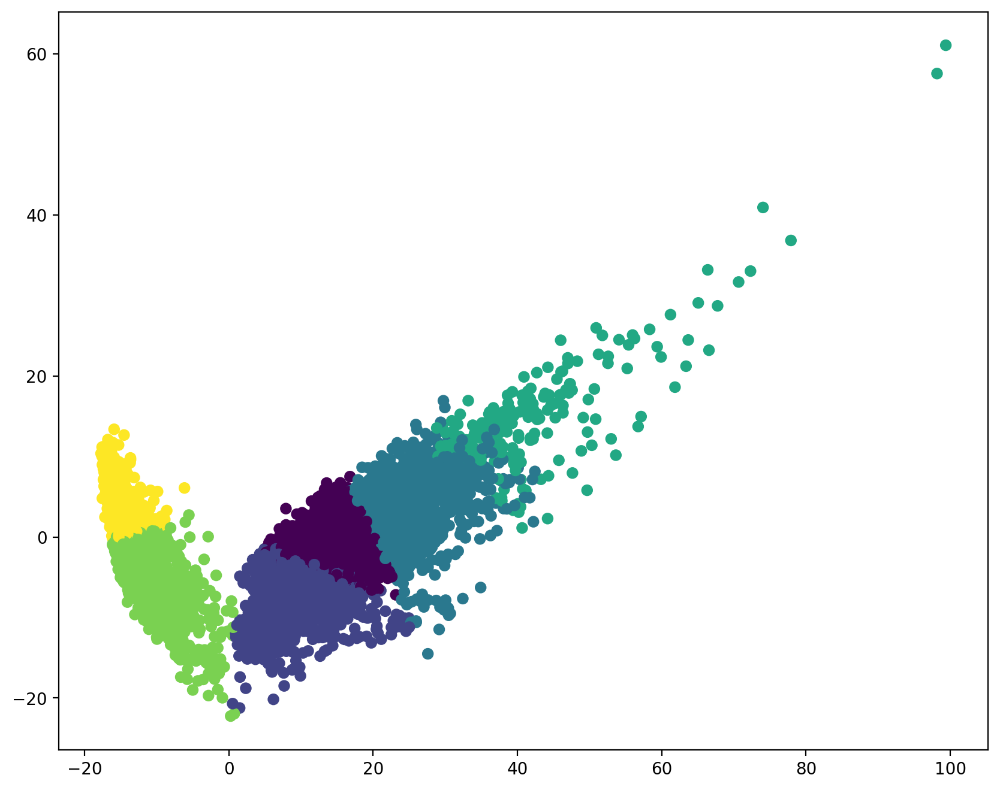

In [420]:
plt.figure(figsize=(10, 8))
plt.scatter(x=X_pca_plot[:, 0], y=X_pca_plot[:, 1], c=bis_means.labels_, label=bis_means.labels_, cmap='viridis')

In [304]:
print_metrics(X=X_pca, y_true=y_true, labels=bis_means.labels_)

Random Index: 0.778457581132452
V-measure: 0.45859853423648117
Silhouette: 0.11759487111387602


__DBSCAN__

In [195]:
def euclidean_distance(arr):
    dists = list()
    for i in range(len(arr)):
        for j in range(len(arr)):
            if i >= j:
                continue
            try:
                dist = np.linalg.norm(arr[i] - arr[j])
                dists.append(dist)
            except:
                continue

    return np.mean(dists)

In [196]:
print(y_true[:5])
print(y_true[100:105])
print(y_true[298:303])
print(y_true[303:308])
print(y_true[8909:8914])

[5 5 5 5 5]
[1 1 1 1 1]
[3 3 3 3 3]
[2 2 2 2 2]
[4 4 4 4 4]


In [229]:
# приблизительное внутрикластерное расстояние на метках из датасета
print(euclidean_distance(X_pca[:5]))
print(euclidean_distance(X_pca[100:105]))
print(euclidean_distance(X_pca[298:303]))
print(euclidean_distance(X_pca[303:308]))
print(euclidean_distance(X_pca[8909:8914]))
print('------------------')
# приблизительное межкластерное
print(euclidean_distance(np.vstack([X_pca[:5], X_pca[100:105], X_pca[298:303], X_pca[303:308], X_pca[8909:8914]])))

13.029491471590442
14.473638865291075
18.59159158909553
12.978444908001615
14.829987660654613
------------------
30.790123302285966


In [360]:
dbs_clust = DBSCAN(eps=17, min_samples=3)

In [361]:
start_time = time.time()

dbs_clust.fit(X_pca)

end_time = time.time()
execution_time = end_time - start_time

print(f"Время выполнения программы: {execution_time} секунд")

Время выполнения программы: 0.610368013381958 секунд


In [362]:
print_metrics(X=X_pca, y_true=y_true, labels=dbs_clust.labels_)

Random Index: 0.20482915271147592
V-measure: 0.022166856078539663
Silhouette: 0.30978584188557096


In [363]:
print('n-labels:', len(set(dbs_clust.labels_)))
set(dbs_clust.labels_)

n-labels: 5


{-1, 0, 1, 2, 3}

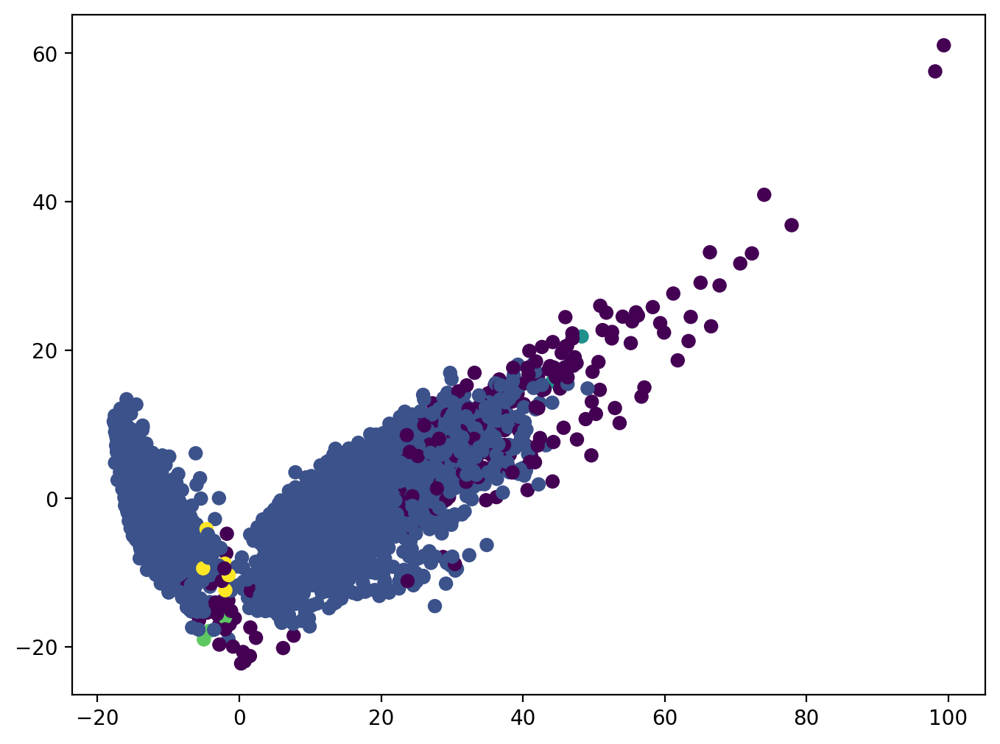

In [364]:
plt.figure(figsize=(8, 6))
plt.scatter(x=X_pca_plot[:, 0], y=X_pca_plot[:, 1], c=dbs_clust.labels_, label=dbs_clust.labels_)
# cmap='virdis'

__Ответ:__ Среди всех алгоритмов лучший результат показала иерархическая кластеризация (```AgglomerativeClustering```).
Этот алгоритм смог верно определить почти 84% меток кластеров и среднее гармоническое homogeneity и completeness равно 0.61. Это значит, что большую часть объектов алгоритм отнес к верным кластерам и общая структера кластеров (визуально на графике в проекции на 2D) также близка к правильной (правильная на графике в конце).  

- homogeneity: each cluster contains only members of a single class.
- completeness: all members of a given class are assigned to the same cluster.

```
Random Index: 0.8388  
V-measure: 0.6134
```

### Задание 1.9 (1 балл)
Для самой успешной из полученных кластеризаций попробуйте дать интерпретацию кластеров. Опишите характеристики объектов, попавших в каждый кластер. Для этого можете ответить на следующие вопросы:

* Похожи ли объекты внутри каждого кластера на определенный тип активности человека?
* В каких кластерах смешано несколько типов активности? С чем, на ваш взгляд, это может быть связано?
* Качественная ли получилась кластеризация? На основании чего вы можете сделать такой вывод?

__Разделение объектов на основе Иерархической кластеризации__

In [397]:
ag_clust_labels = ag_cluster.labels_

In [398]:
df_pca_2 = pd.concat([pd.DataFrame(X_pca_plot), pd.DataFrame(ag_clust_labels, columns=['target'])], axis=1)

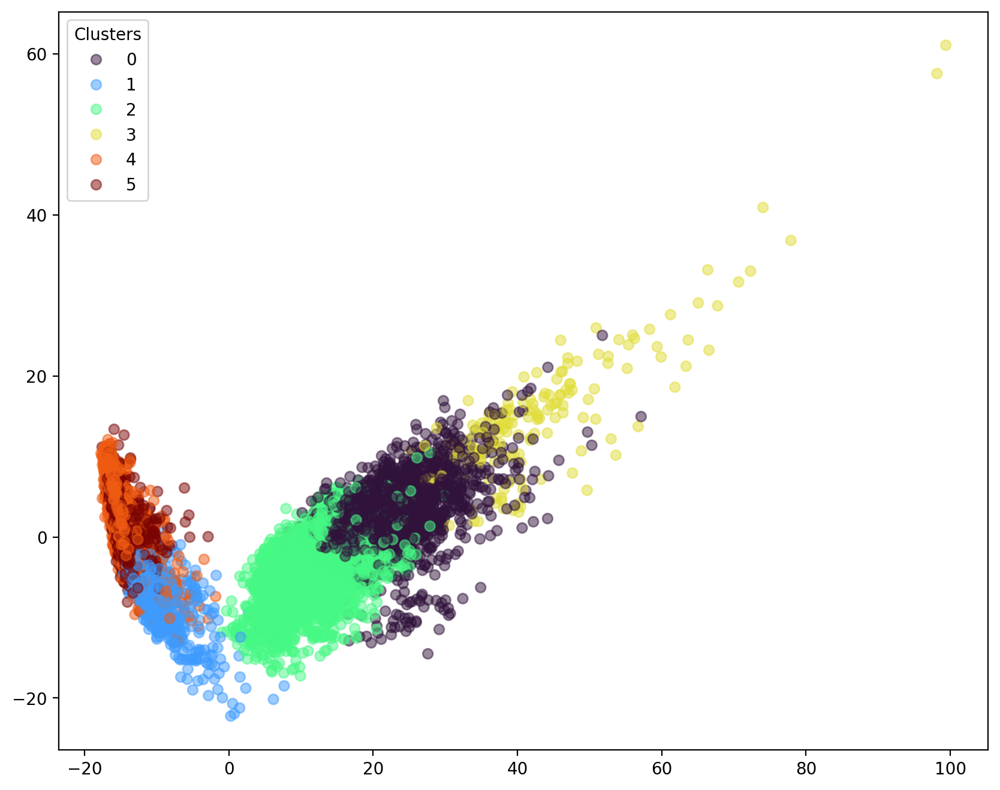

In [452]:
plt.figure(figsize=(10, 8))
result = plt.scatter(x=X_pca_plot[:, 0], y=X_pca_plot[:, 1], c=ag_clust_labels, cmap='turbo', alpha=0.5)
plt.legend(handles=result.legend_elements()[0], labels=list(set(ag_clust_labels)), title='Clusters')

In [384]:
df_pca_67 = pd.concat([pd.DataFrame(X_pca), pd.DataFrame(ag_clust_labels, columns=['target'])], axis=1)

arrs_lst = list()
for label in list(set(ag_clust_labels)):
    arr = df_pca_67[df_pca_67['target'] == label].to_numpy()
    arrs_lst.append(arr)
    print(f'Mean intra-cluster distance for label {label}:', euclidean_distance(arr))

Mean intra-cluster distance for label 0: 26.279457471139423
Mean intra-cluster distance for label 1: 20.452883068971733
Mean intra-cluster distance for label 2: 19.90529362493901
Mean intra-cluster distance for label 3: 38.45190179117274
Mean intra-cluster distance for label 4: 16.10150147587163
Mean intra-cluster distance for label 5: 13.339250355434352


__<h4>Что могли бы означать выделенные иерархиической кластеризацией группы:</h4>__
*\*Здесь я расуждаю, держа в голове 6 возможных групп состяний-активностей*
- __0 кластер - *подъем по лестнице*__, так как увеличивается дисперсия, но при этом кучность все еще присутствует (в отличие от спуска по лестнице - подниматься по ней тяжелее для большинства)
- __1 кластер - *лежание*__, так как дисперсия мала и кучность на высоком уровне - состояние покоя
- __2 кластер - *ходьба*__, так как объекты расположены плотно, но при этом большим облаком (много вариантов с темпом ходьбы, стилем ходьбы и так далее)
- __3 кластер - *спуск по лестнице*__, так как разброс стал еще сильнее, чем в кластере 1 (люди достаточно разнородно спускаются с лестницы, кто-то быстро почти бегом, кто-то насьупает на каждую ступеньку)
- __4 кластер - *сидение*__, так как более статичные процесс, чем лежание, но при этом могут быть некоторые движения ногами
- __5 кластер - *стояние*__, так как стоять можно по-разному, постоянно по чуть-чуть перемещая ноги и поочередно опираясь на каждую (кучность уменьшилась, но при этом дисперсия не так высока, как в ходьбе)

__<h4>Сложности:</h4>__
При такой кластеризации достаточно сложно разделить между собой почти статичные состояния - лежания, сидения, стояния, так как они похожи, так как озночают бездействие.

__<h4>Качество:</h4>__
Кластеризация получилась неидеальной, но близкой к правде (это если сравнить с оригинальными метками по метрикам и визуальному сравнению в проекции 2D). Если же абстрагироваться от оригинальных меток - то можно судить о качестве так: я смог сделать некоторые предположения и выводы на оснвое графика + внутрикалстерного расстояния, которые имеют логическое обоснование, значит моя кластеризация имеет смысл физический и практический.

__Верное разделение объектов__

In [458]:
clusters_dict = {
    1: 'ходьба',
    2: 'подъем вверх по лестнице',
    3: 'спуск по лестнице',
    4: 'сидение',
    5: 'стояние',
    6: 'лежание'
}

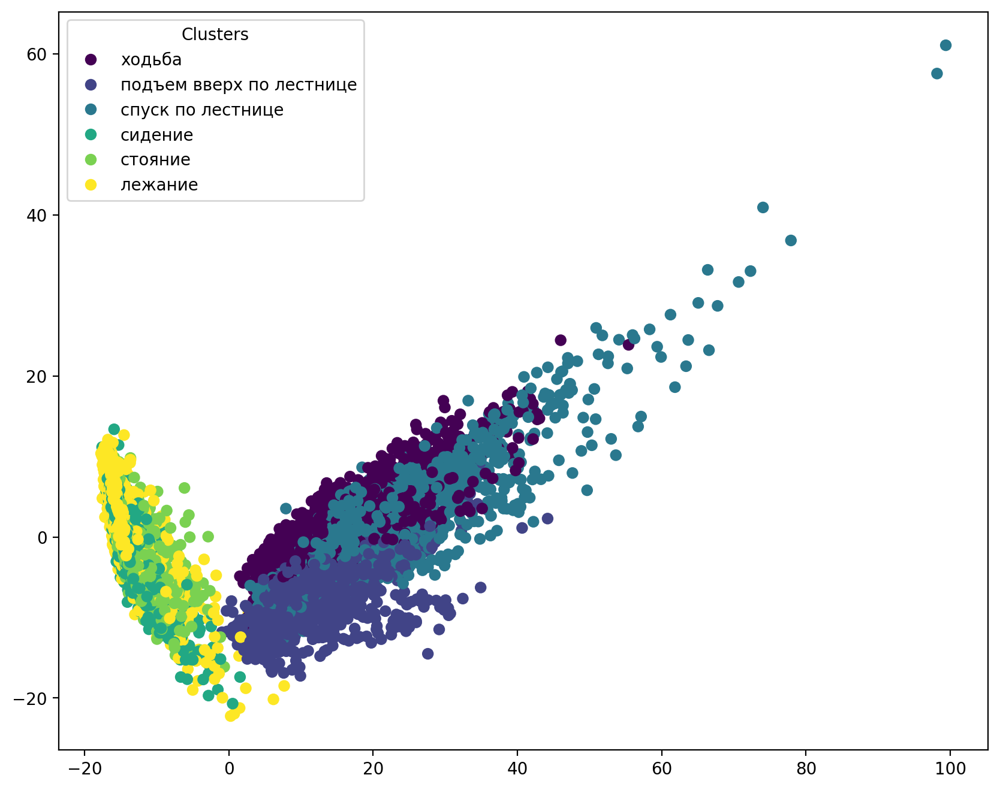

In [459]:
plt.figure(figsize=(10, 8))
result = plt.scatter(x=X_pca_plot[:, 0], y=X_pca_plot[:, 1], c=y_true, cmap='viridis')
plt.legend(handles=result.legend_elements()[0], labels=clusters_dict.values(), title='Clusters')

## Задание 2. Разделение изображения на семантические компоненты (5 баллов)

![RedPanda](https://imgur.com/6Aa52Lm)

Алгоритмы кластеризации могут применяться в самых разных задачах. Например, в анализе изображений есть задача разделения изображения на семантические компоненты, которую можно решать в том числе с помощью алгоритмов кластеризации.

Проверим их на ```duck.jpg``` и ```owls.jpg```

### Задание 2.0 (0.1 балл)

Откройте изображения, после чего визуализируйте их с помощью ```plt.imshow()```

In [4]:
from PIL import Image
import cv2

In [5]:
def take_rgb_img(img_path):
    img = cv2.imread(img_path, cv2.IMREAD_COLOR)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img_rgb

In [6]:
img_duck = cv2.imread(f'{path}Duck.jpg', cv2.IMREAD_COLOR)
img_owls = cv2.imread(f'{path}Owls.jpg', cv2.IMREAD_COLOR)

In [7]:
img_duck_rgb = cv2.cvtColor(img_duck, cv2.COLOR_BGR2RGB)
img_owls_rgb = cv2.cvtColor(img_owls, cv2.COLOR_BGR2RGB)

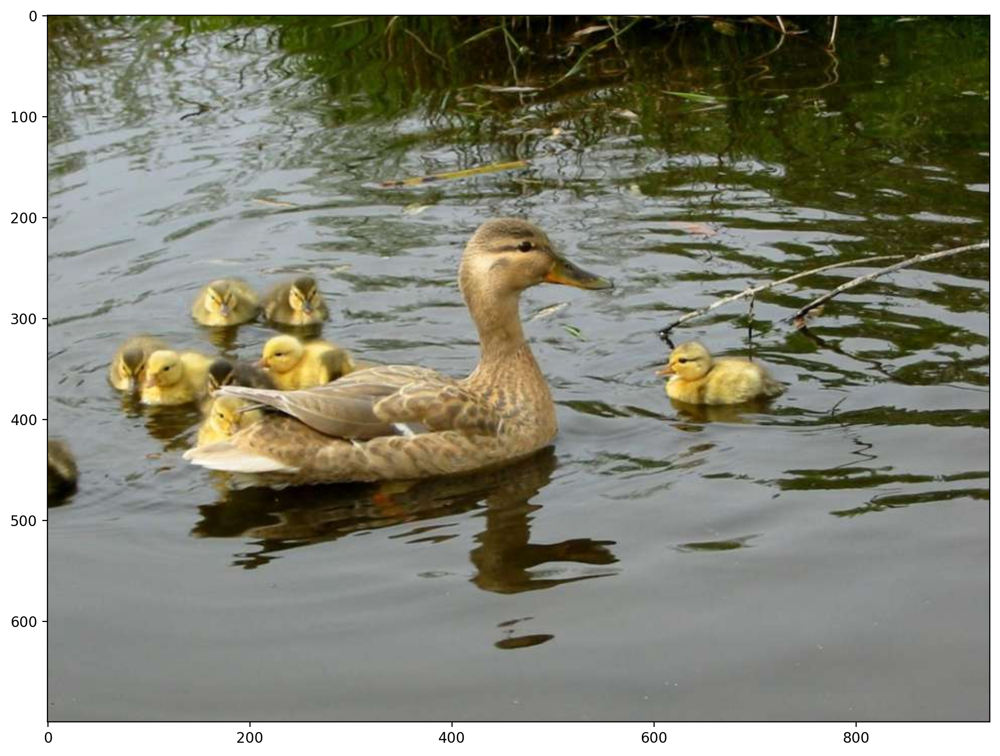

In [467]:
plt.imshow(img_duck_rgb)
plt.show()

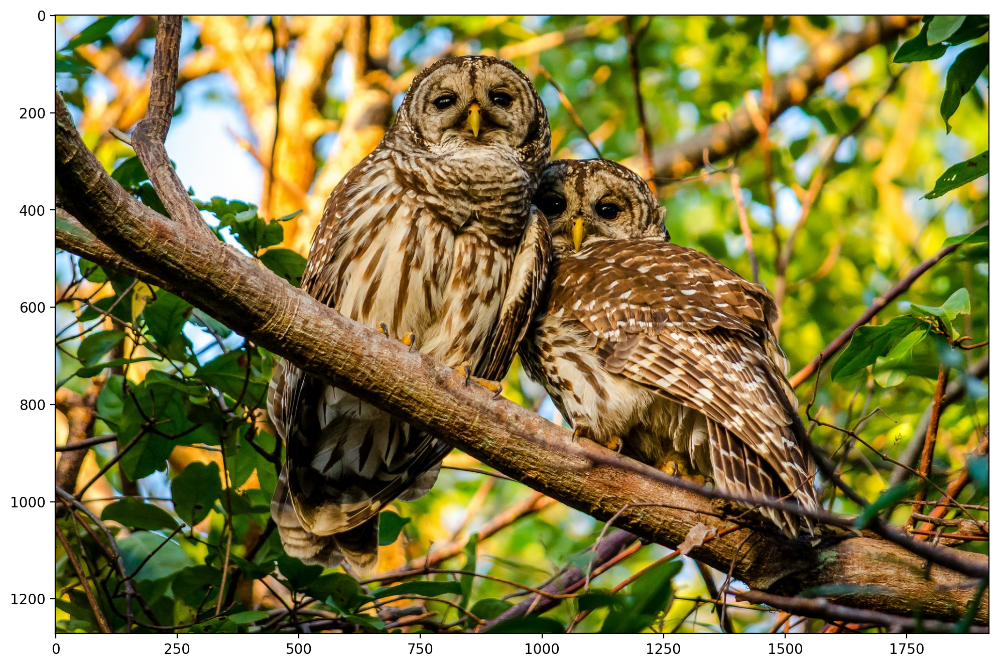

In [610]:
plt.imshow(img_owls_rgb)
plt.show()

### Задание 2.1 (1.5 балла)
Для каждого изображения, используя кластеризацию ```KMeans```, выделите компоненты, охарактеризовав каждый пиксель следующим образом: $\psi_i = [\lambda x_i, \lambda y_i, r_i, g_i, b_i]$, где
$x_i$ и $y_i$ — координаты пикселя, $r_i, g_i, b_i$ — его цвет, $\lambda$ — параметр, выражающий важность пространственной связности перед цветовой похожестью.

Примените полученную функцию, взяв следующие $\lambda$: 0.3 и 1.5 для ```duck.jpg``` и ```owls.jpg``` (или другие, но тогда с вас красивые результаты :) )

Число кластеров подберите разумным образом на свой вкус (в качестве нулевого приближения можно взять 3)

In [8]:
def time_wrap(func):
    def wrapper(*args, **kwargs):
        start_time = time.time()
        result = func(*args, **kwargs)
        end_time = time.time()
        execution_time = end_time - start_time
        print(f"Execution time: {round(execution_time, 5)} seconds.")
        return result
    return wrapper

In [9]:
@time_wrap
def find_components(image, lmbd, n_clusters, random_state):
    # получим массив с расположением пикселей, нормированных на лямбду
    print(f'{time.ctime()} Start processing data...')
    new_img_data = list()
    for i in range(image.shape[0]):
        line_tmp = list()
        for j in range(image.shape[1]):
            line_tmp.append(
                np.hstack([np.array([lmbd * j, lmbd * i]), image[i, j, :]])
            )
        
        new_img_data.append(line_tmp)

    new_shape = list(image.shape)
    new_shape[2] = 5
    new_img_data = np.array(new_img_data).reshape(*new_shape)
    print(f'{time.ctime()} NP array is ready.')
    
    # преобразуем в датафрейм для обучения модели
    print(f'{time.ctime()} Make dataframe for learning...')
    n_rows = new_shape[0] * new_shape[1]
    new_img_df = pd.DataFrame(
        new_img_data.reshape(n_rows, 5),
        columns=['x_lambda', 'y_lambda', 'red', 'green', 'blue']
    )

    # обучим модель
    print(f'{time.ctime()} Start modeling and fitting...')
    model = KMeans(n_clusters=n_clusters, random_state=random_state, n_init=100)
    model.fit(new_img_df)
    print(f'{time.ctime()} Successfully fitted.')

    # соеденим метки кластеров с датафреймом
    new_img_df = pd.concat([new_img_df, pd.DataFrame(model.labels_, columns=['cluster'])], axis=1)

    # сделаем индексом координаты пикселя
    new_img_df['x'] = (new_img_df['x_lambda'] / lmbd + 0.000000001).astype(int)
    new_img_df['y'] = (new_img_df['y_lambda'] / lmbd + 0.000000001).astype(int)
    new_img_df = new_img_df.set_index(keys=['x', 'y'], drop=True)

    # недочет реализации - ограниченное кол-во цветов -> ограниченное количество кластеров
    colors = {
        'blue': [0, 0, 255],
        'red': [255, 0, 0],
        'green': [0, 204, 0],
        'black': [0, 0, 0],
        'pink': [255, 51, 153],
        'orange': [255, 128, 0],
        'violet': [153, 51, 255],
        'ultramarine': [0, 255, 255],
        'yellow': [255, 255, 0],
        'dark blue': [0, 76, 153],
    }
    # сделаем матрицу наложения цветов кластеров
    print(f'{time.ctime()} Start making overlaying matrix with clusters...')
    overlay = image.copy()
    for i in range(new_shape[0]):
        for j in range(new_shape[1]):
            label = int(new_img_df.loc[j, i]['cluster'])
            overlay[i, j] = list(colors.values())[label]

    print(f'{time.ctime()} Overlaying matrix is created!')
    
    return overlay

Mon Mar 11 20:14:13 2024 Start processing data...
Mon Mar 11 20:14:16 2024 NP array is ready.
Mon Mar 11 20:14:16 2024 Make dataframe for learning...
Mon Mar 11 20:14:16 2024 Start modeling and fitting...
Mon Mar 11 20:14:25 2024 Successfully fitted.
Mon Mar 11 20:14:25 2024 Start making overlaying matrix with clusters...
Mon Mar 11 20:15:25 2024 Overlaying matrix is created!
Execution time: 72.23137 seconds.


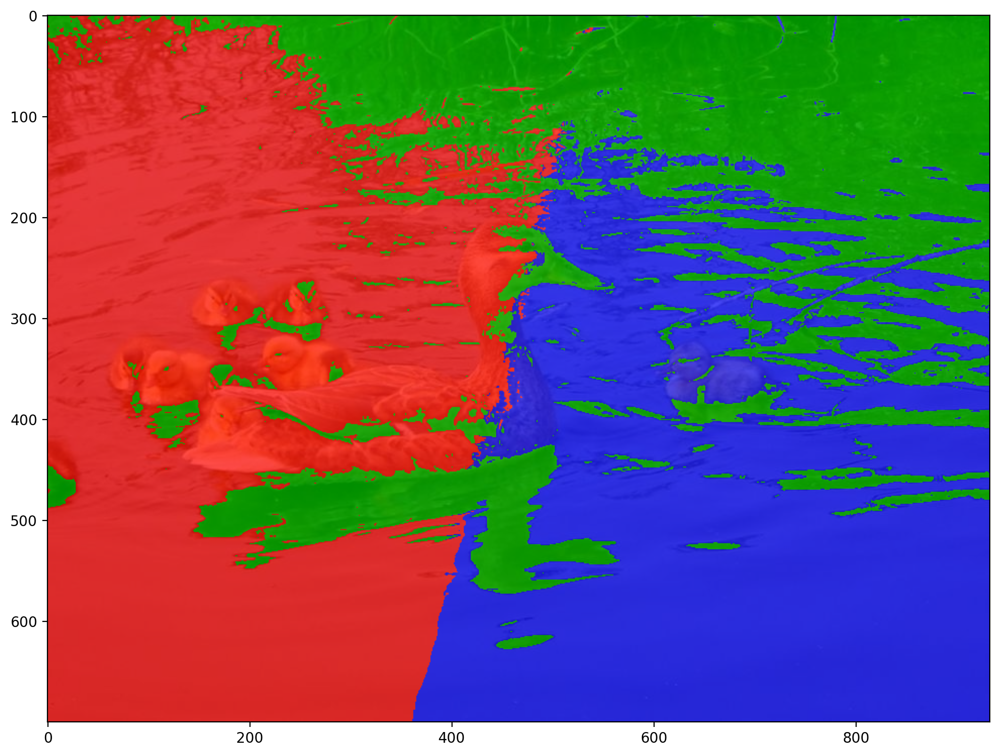

In [10]:
overlay_duck_kmeans = find_components(img_duck_rgb, 0.3, 3, RANDOM_STATE)
plt.imshow(img_duck_rgb)
plt.imshow(overlay_duck_kmeans, alpha=0.7)

Mon Mar 11 04:17:20 2024 Start processing data...
Mon Mar 11 04:17:23 2024 NP array is ready.
Mon Mar 11 04:17:23 2024 Make dataframe for learning...
Mon Mar 11 04:17:23 2024 Start modeling and fitting...
Mon Mar 11 04:17:36 2024 Successfully fitted.
Mon Mar 11 04:17:36 2024 Start making overlaying matrix with clusters...
Mon Mar 11 04:18:38 2024 Overlaying matrix is created!
Execution time: 77.2604 seconds.


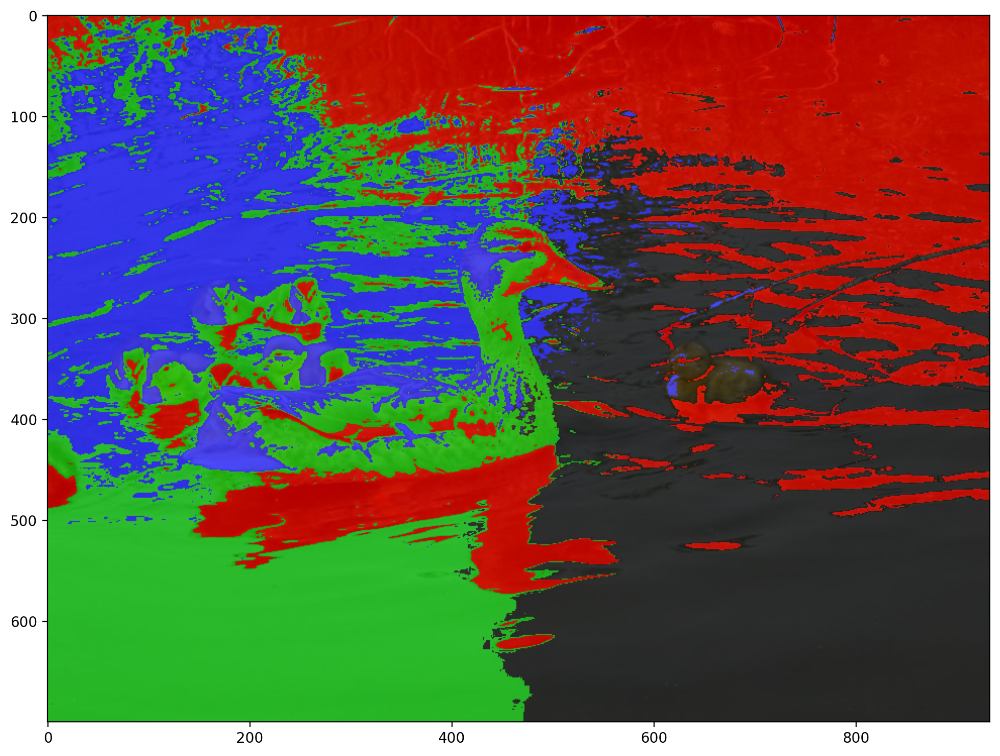

In [733]:
overlay_duck_kmeans = find_components(img_duck_rgb, 0.2, 4, RANDOM_STATE)
plt.imshow(img_duck_rgb)
plt.imshow(overlay_duck_kmeans, alpha=0.7)

__Comment:__ Отражение уточки нашел лучше всего, но туда еще входит половина фото )))

Mon Mar 11 04:22:16 2024 Start processing data...
Mon Mar 11 04:22:28 2024 NP array is ready.
Mon Mar 11 04:22:28 2024 Make dataframe for learning...
Mon Mar 11 04:22:28 2024 Start modeling and fitting...
Mon Mar 11 04:23:13 2024 Successfully fitted.
Mon Mar 11 04:23:13 2024 Start making overlaying matrix with clusters...
Mon Mar 11 04:27:19 2024 Overlaying matrix is created!
Execution time: 303.14961 seconds.


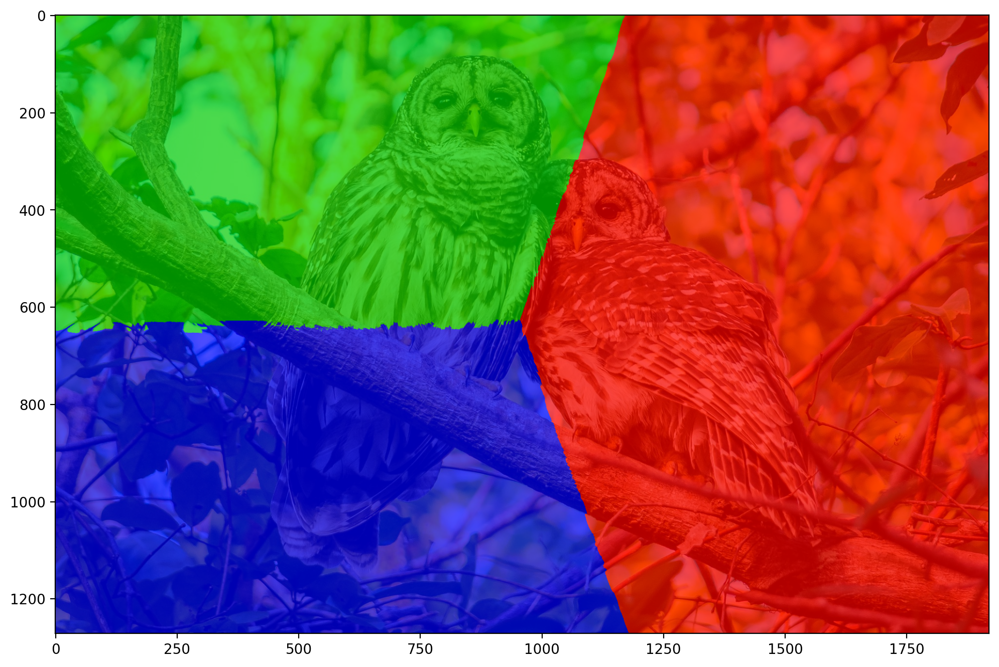

In [736]:
# при параметрах из условия кластеризация на данном фото бесполезна
overlay_owls_kmeans = find_components(img_owls_rgb, 1.5, 3, RANDOM_STATE)
plt.imshow(img_owls_rgb)
plt.imshow(overlay_owls_kmeans, alpha=0.7)

Mon Mar 11 04:43:30 2024 Start processing data...
Mon Mar 11 04:43:42 2024 NP array is ready.
Mon Mar 11 04:43:42 2024 Make dataframe for learning...
Mon Mar 11 04:43:42 2024 Start modeling and fitting...
Mon Mar 11 04:44:43 2024 Successfully fitted.
Mon Mar 11 04:44:44 2024 Start making overlaying matrix with clusters...
Mon Mar 11 04:48:43 2024 Overlaying matrix is created!
Execution time: 312.41458 seconds.


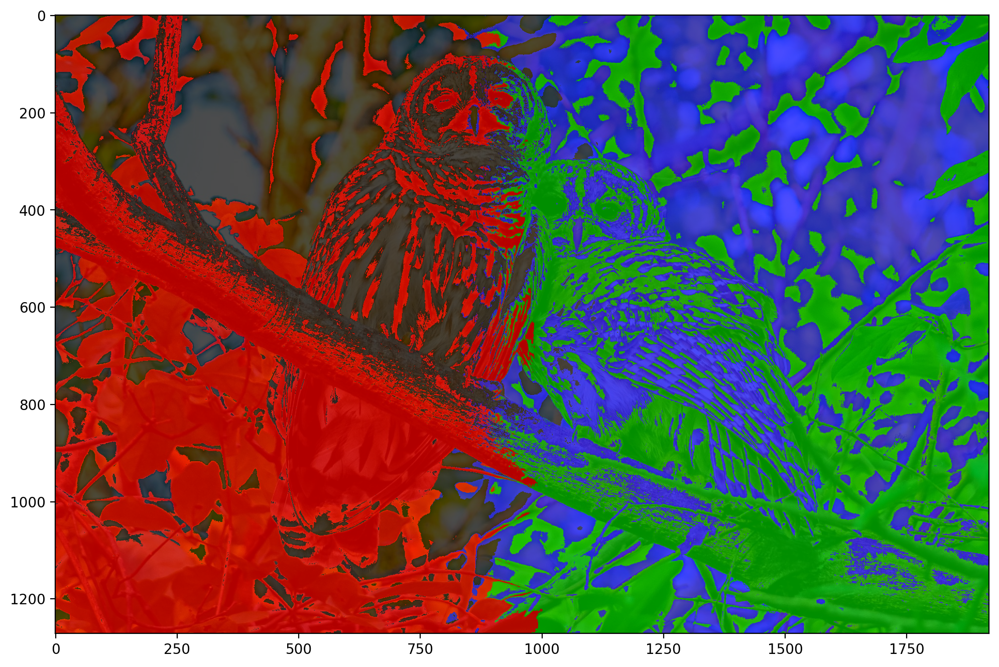

In [749]:
# при параметрах из условия кластеризация на данном фото бесполезна
overlay_owls_kmeans = find_components(img_owls_rgb, 0.2, 4, RANDOM_STATE)
plt.imshow(img_owls_rgb)
plt.imshow(overlay_owls_kmeans, alpha=0.7)

Tue Mar 12 02:57:33 2024 Start processing data...
Tue Mar 12 02:57:44 2024 NP array is ready.
Tue Mar 12 02:57:44 2024 Make dataframe for learning...
Tue Mar 12 02:57:44 2024 Start modeling and fitting...
Tue Mar 12 03:00:40 2024 Successfully fitted.
Tue Mar 12 03:00:40 2024 Start making overlaying matrix with clusters...
Tue Mar 12 03:04:36 2024 Overlaying matrix is created!
Execution time: 423.92804 seconds.


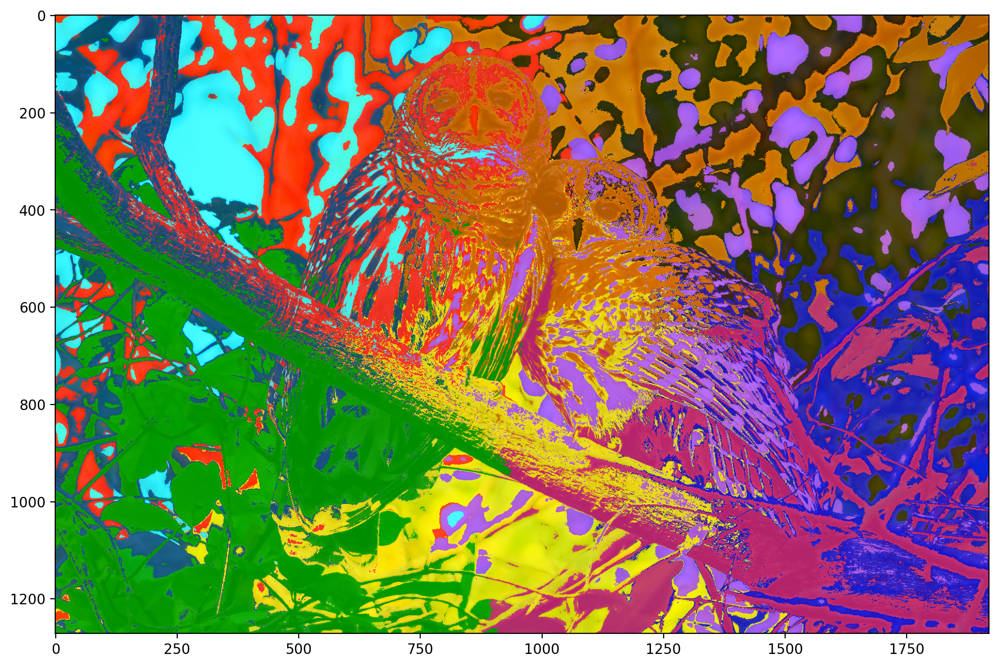

In [136]:
# при параметрах из условия кластеризация на данном фото бесполезна
overlay_owls_kmeans = find_components(img_owls_rgb, 0.15, 10, RANDOM_STATE)
plt.imshow(img_owls_rgb)
plt.imshow(overlay_owls_kmeans, alpha=0.7)

### Задание 2.2 (1.5 балла)
Попробуйте выделить сегменты при помощи [спектральной кластеризации](http://scikit-learn.org/stable/modules/clustering.html#spectral-clustering). Обратите внимание на [пример в sklearn](http://scikit-learn.org/0.16/auto_examples/cluster/plot_lena_segmentation.html). Для ускорения работы алгоритма рекомендуется привести изображение к серому цвету. При необходимости можно сжать изображения в 2 раза.

Подсказка: ```skimage``` с его ```color``` и ```transform``` в этом помогут :)

Или же воспользуйтесь аналогичными средствами ```PIL``` или ```cv2```

In [140]:
def spectral_segmentation(src_image, n_clusters=3, beta=5, eps=1e-6, random_state=42, gray=False, size_share=0.3):
    # Convert to gray
    if gray:
        img_gray = cv2.cvtColor(src_image, cv2.COLOR_RGB2BGR)
    else:
        img_gray = src_image
    
    # Decrease 
    img_gray_small = cv2.resize(img_gray, (0, 0), fx=size_share, fy=size_share)
    
    # Convert the image into a graph with the value of the gradient on the edges.
    graph = image.img_to_graph(img_gray_small)
    
    # Take a decreasing function of the gradient: an exponential
    # The smaller beta is, the more independent the segmentation is of the
    # actual image. For beta=1, the segmentation is close to a voronoi
    graph.data = np.exp(-beta * graph.data / img_duck_rgb.std()) + eps
    
    ###############################################################################
    # Visualize the resulting regions
    
    for assign_labels in ('kmeans', 'discretize'):
        t0 = time.time()
        labels = spectral_clustering(
            graph,
            n_clusters=n_clusters,
            eigen_solver='amg',
            assign_labels=assign_labels,
            random_state=random_state
        )
        t1 = time.time()
        labels = labels.reshape(img_gray_small.shape)
    
        plt.figure(figsize=(5, 5))
        plt.imshow(img_gray_small, cmap=plt.cm.gray)
        for l in range(N_REGIONS):
            plt.contour(np.sum(labels == l, axis=2) == 3,
                        colors=[plt.cm.brg(l / float(N_REGIONS)), ])
        plt.xticks(())
        plt.yticks(())
        plt.title('Spectral clustering: %s, %.2fs' % (assign_labels, (t1 - t0)))
    
    plt.show()

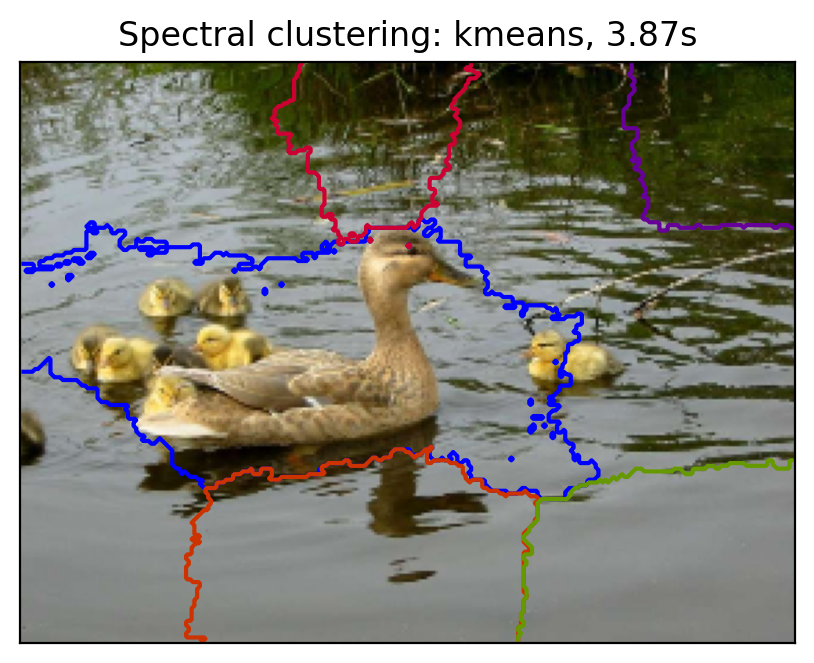

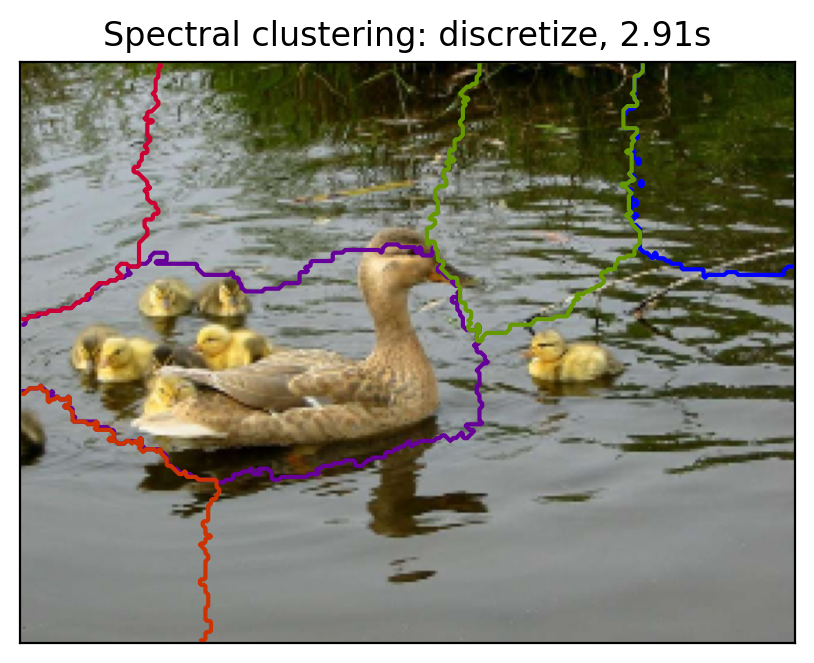

In [133]:
spectral_segmentation(img_duck_rgb, n_clusters=10, beta=1.5, eps=1e-8, random_state=RANDOM_STATE)

С уточками в отдельном кластере достаточно удачно получилось

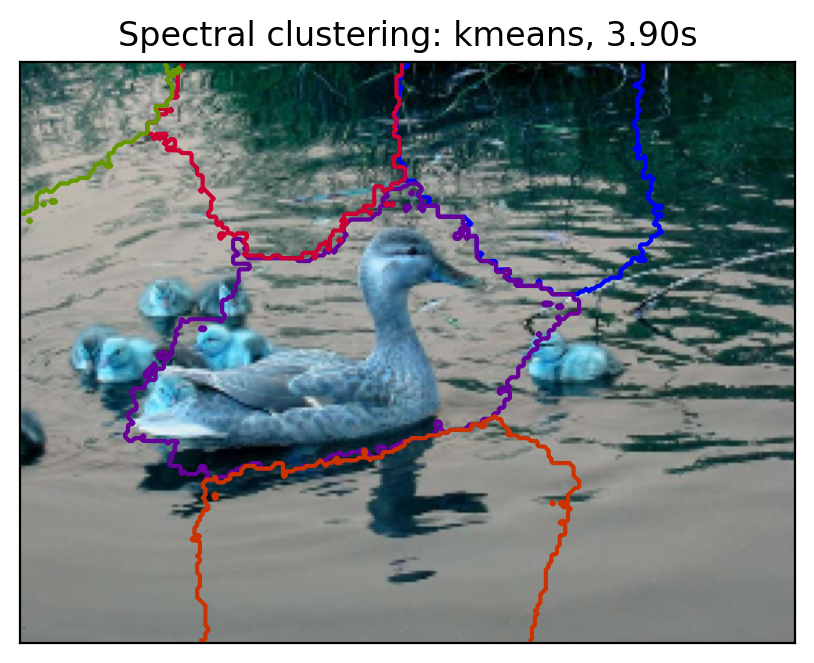

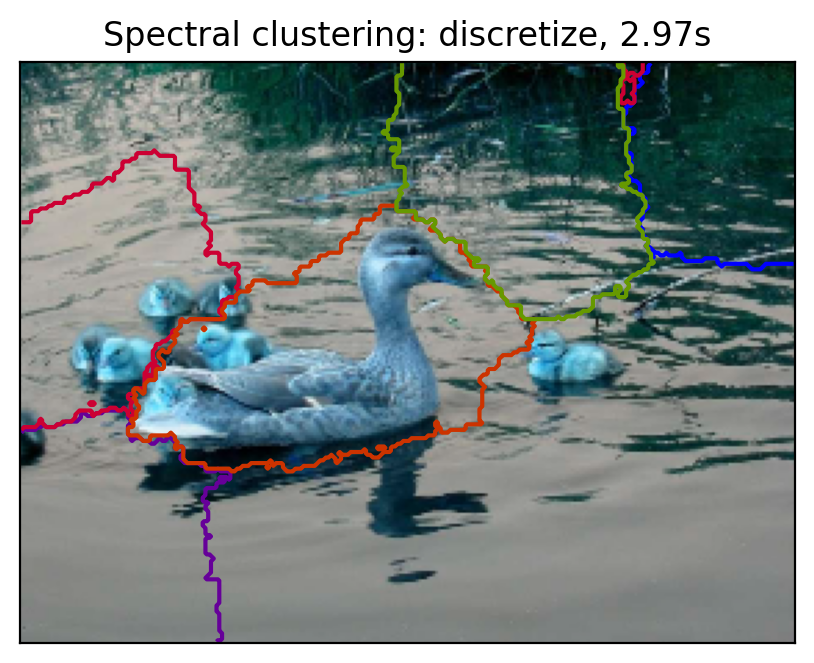

In [135]:
spectral_segmentation(img_duck_rgb, n_clusters=10, beta=1.5, eps=1e-8, random_state=RANDOM_STATE, gray=True)

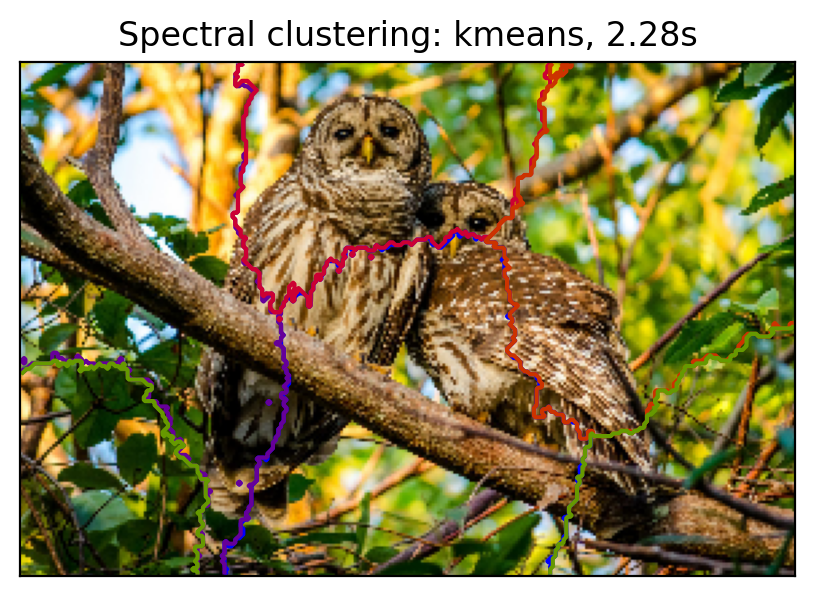

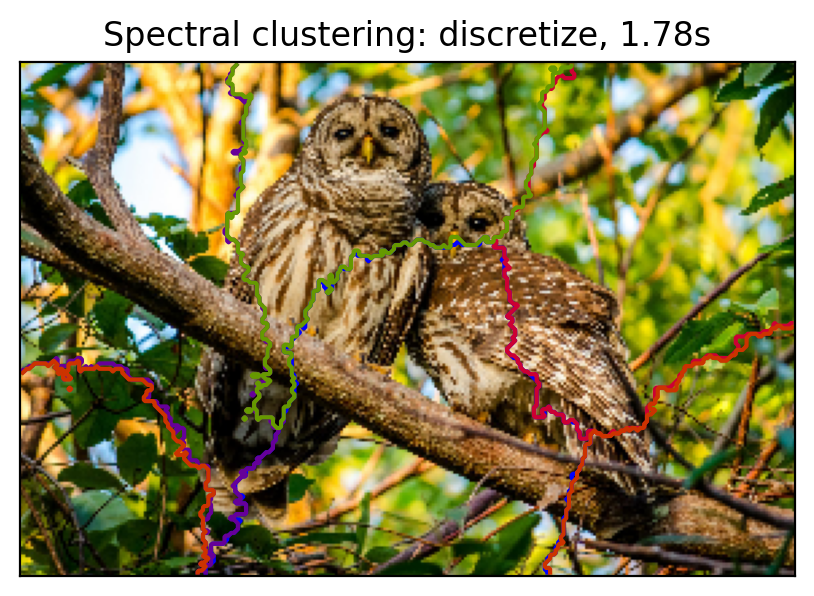

In [142]:
spectral_segmentation(img_owls_rgb, n_clusters=5, beta=1.5, eps=1e-8, random_state=RANDOM_STATE, size_share=0.15)

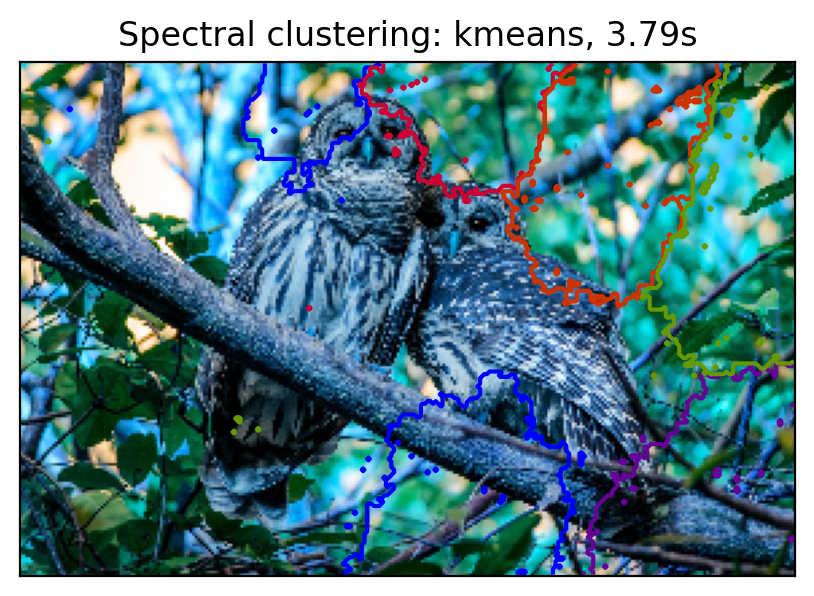

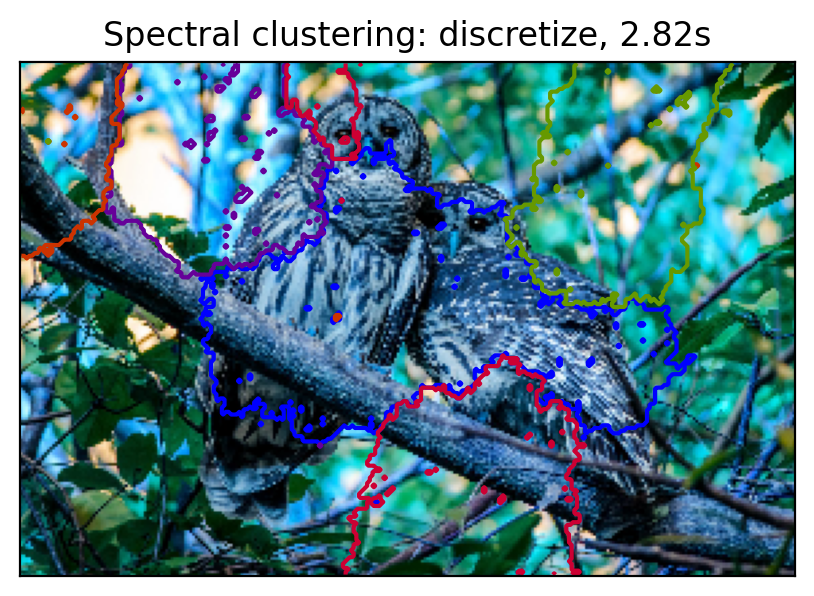

In [145]:
spectral_segmentation(img_owls_rgb, n_clusters=10, beta=3, eps=1e-6, random_state=RANDOM_STATE, size_share=0.15, gray=True)

### Задание 2.3 (0.9 баллов)
Визуализируйте результаты сегментации (аналогично рисунку в начале задания 2) для обоих методов.

__Визаулизации были сопровождением к каждой модели выше__

### Задание 2.4 (1 балл)
Найдите интересную картинку милого животного и примените алгоритмы и к ней. Поэкспериментируйте с параметрами алгоритмов. Картинку нужно будет загрузить вместе с работой. Слишком большие лучше не брать - считаться будет долго. Не забудьте визуализировать!

Сравните два подхода и сегментации, к которым они приводят.
Для всех ли изображений в результате сегментации хорошо видны контуры объектов?

In [147]:
stranger_rgb = take_rgb_img(f'{path}stranger.jpg')

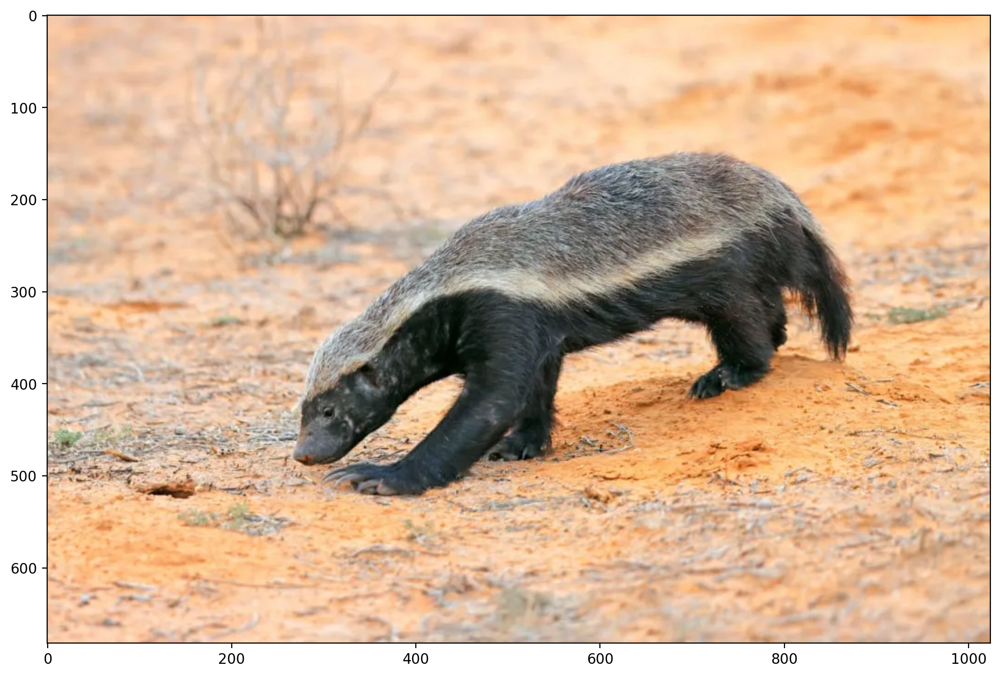

In [741]:
plt.imshow(stranger_rgb)

In [148]:
cats_rgb = take_rgb_img(f'{path}cats.jpg')

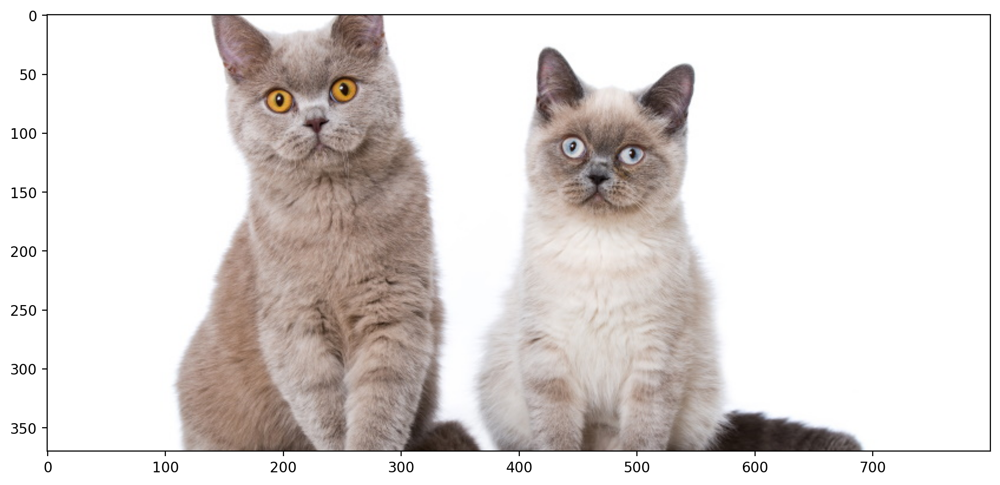

In [744]:
plt.imshow(cats_rgb)

#### K-MEANS

Mon Mar 11 04:37:51 2024 Start processing data...
Mon Mar 11 04:37:54 2024 NP array is ready.
Mon Mar 11 04:37:54 2024 Make dataframe for learning...
Mon Mar 11 04:37:54 2024 Start modeling and fitting...
Mon Mar 11 04:38:01 2024 Successfully fitted.
Mon Mar 11 04:38:01 2024 Start making overlaying matrix with clusters...
Mon Mar 11 04:39:15 2024 Overlaying matrix is created!
Execution time: 84.36296 seconds.


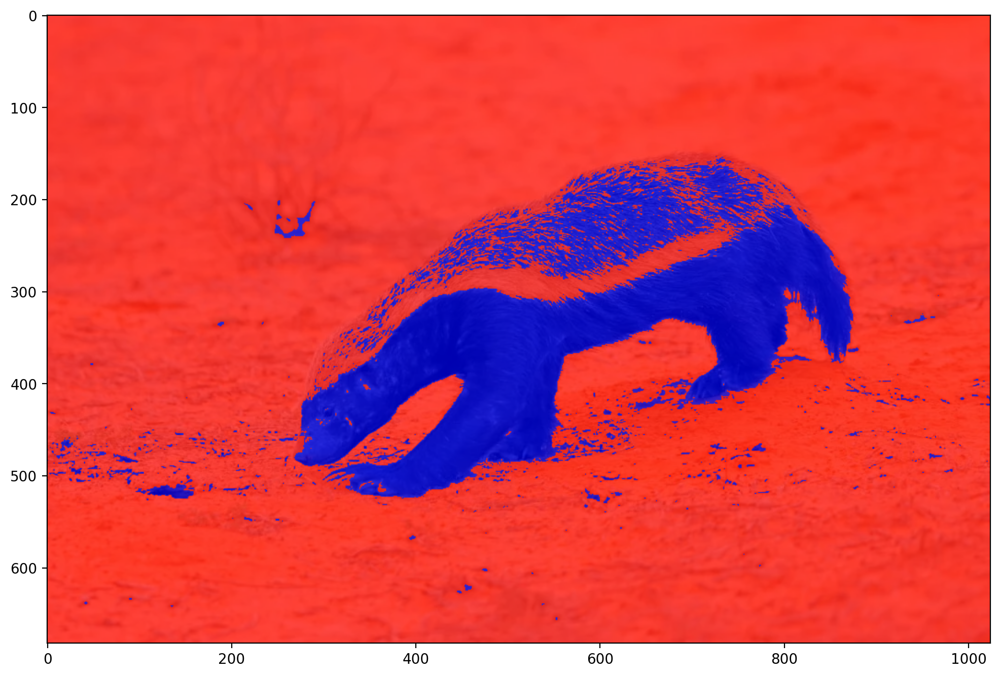

In [746]:
overlay_stranger_kmeans = find_components(stranger_rgb, 0.15, 2, RANDOM_STATE)
plt.imshow(stranger_rgb)
plt.imshow(overlay_stranger_kmeans, alpha=0.7)

Mon Mar 11 04:50:14 2024 Start processing data...
Mon Mar 11 04:50:15 2024 NP array is ready.
Mon Mar 11 04:50:15 2024 Make dataframe for learning...
Mon Mar 11 04:50:15 2024 Start modeling and fitting...
Mon Mar 11 04:50:17 2024 Successfully fitted.
Mon Mar 11 04:50:18 2024 Start making overlaying matrix with clusters...
Mon Mar 11 04:50:50 2024 Overlaying matrix is created!
Execution time: 36.14183 seconds.


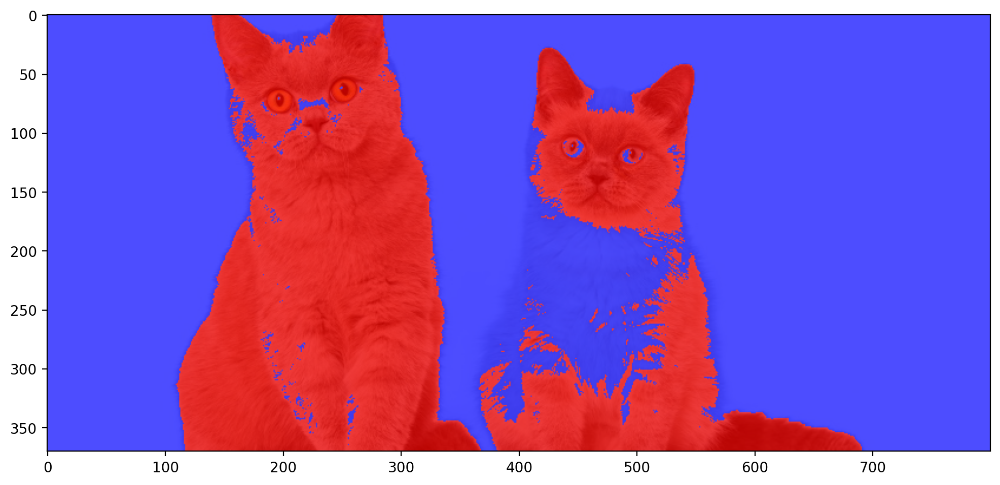

In [751]:
overlay_cats_kmeans = find_components(cats_rgb, 0.05, 2, RANDOM_STATE)
plt.imshow(cats_rgb)
plt.imshow(overlay_cats_kmeans, alpha=0.7)

#### SPECTRAL FROM DOCS

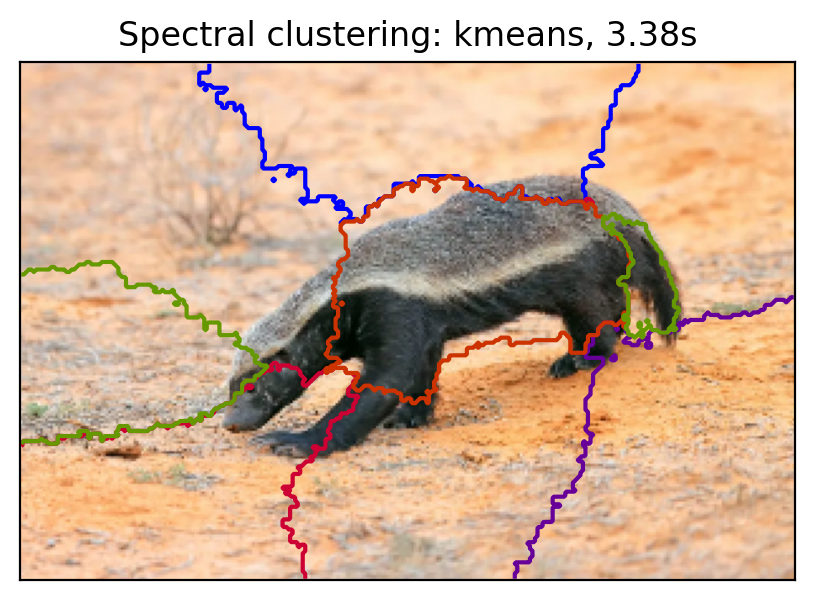

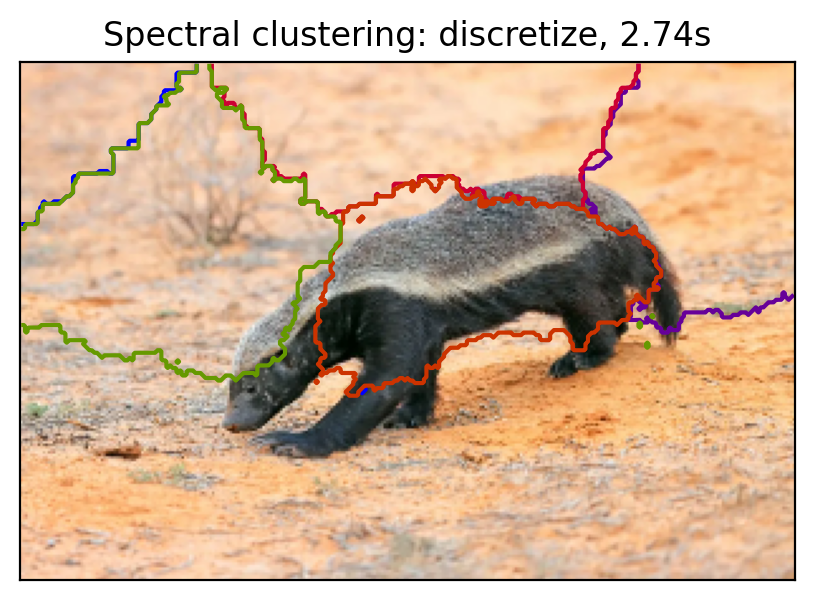

In [189]:
spectral_segmentation(
    stranger_rgb, n_clusters=8, beta=4.8, eps=1e-3,
    random_state=RANDOM_STATE, size_share=0.3, gray=False
)

/Users/dsbulg10/Desktop/study/repos/ml_study_hws/env/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:393: UserWarning: Exited at iteration 6 with accuracies 
[3.06865437e-16 1.04132137e-03 1.05134954e-03 1.87055123e-03
 8.81657670e-04 9.67549057e-04]
not reaching the requested tolerance 0.0011909008026123047.
Use iteration 6 instead with accuracy 
0.0009687381442401239.

  _, diffusion_map = lobpcg(laplacian, X, M=M, tol=tol, largest=False)
/Users/dsbulg10/Desktop/study/repos/ml_study_hws/env/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:393: UserWarning: Exited postprocessing with accuracies 
[4.52400276e-16 1.04132137e-03 1.05134954e-03 1.87055123e-03
 8.81657670e-04 9.67549057e-04]
not reaching the requested tolerance 0.0011909008026123047.
  _, diffusion_map = lobpcg(laplacian, X, M=M, tol=tol, largest=False)
/Users/dsbulg10/Desktop/study/repos/ml_study_hws/env/lib/python3.9/site-packages/sklearn/manifold/_spectral_embedding.py:393: UserWar

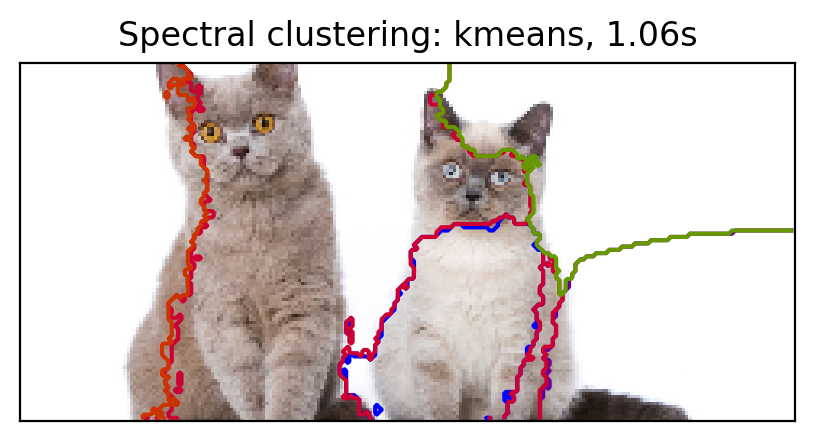

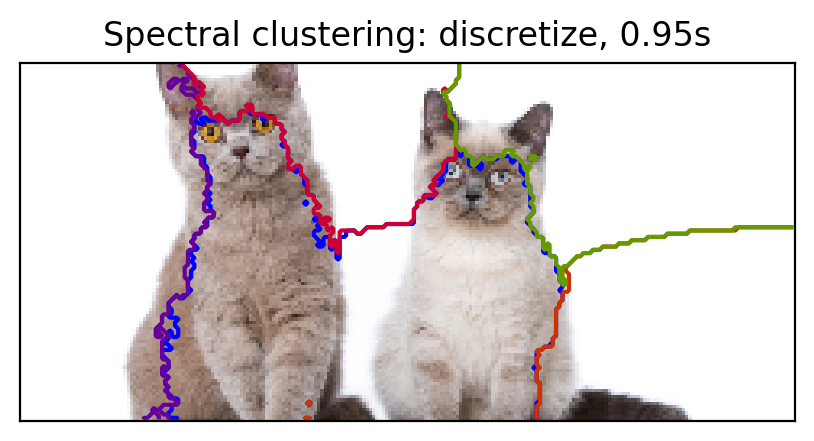

In [213]:
spectral_segmentation(
    cats_rgb, n_clusters=5, beta=20, eps=1e-3,
    random_state=RANDOM_STATE, size_share=0.3, gray=False
)

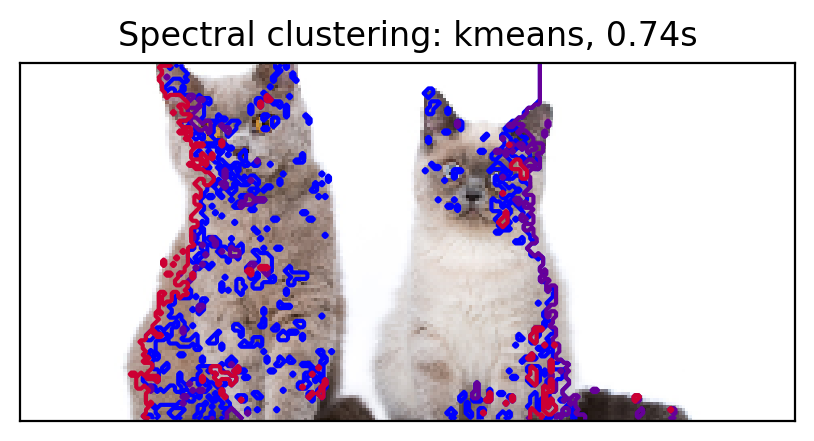

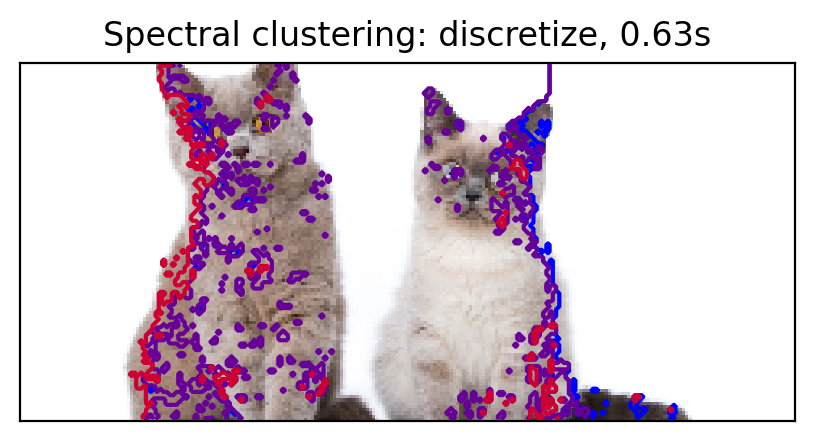

In [228]:
spectral_segmentation(
    cats_rgb, n_clusters=3, beta=40, eps=1e-5,
    random_state=RANDOM_STATE, size_share=0.3, gray=False
)

__Выводы:__
1. Были опробованы методы кластеризации Kmeans и Спектральной кластеризации на изображениях
2. Чистый Kmeanas справлялся лучше на простых картинках, когда пиксели определенного цвета ярко выделлись на общем фоне, как например с котиками и тем "Незнакомцем" (stranger). Спектральная кластеризация показала себя лучше в выделении большого кол-ва кластеров и поиске различных фрагментов изображения
3. В настройке спектральной, возможно, я не очень разобрался, раз кластеризовать котиков, идеально отделив белый фон, не получилось.
4. Контуры хорошо видны не у всех объектов, но уточек, половину от сов, часть котиков получилось выделить спектральной кластеризацией (с визулизацией контура). При применении Kmeans было хуже в случае со сложными изображениями, так как видимо центр тяжести явный мог найтись только в облаке выделяющихся однотонных пикселей.